<a href="https://colab.research.google.com/github/menna03/Credit-Card-Fraud-Detection/blob/main/Credit_Card_Fraud_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import KMeans
from matplotlib.ticker import PercentFormatter

In [3]:
creditcard = pd.read_csv('/content/creditcard.csv')


In [4]:
creditcard.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0.0
1,0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0.0
2,1,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0.0
3,1,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0.0
4,2,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0.0


In [6]:
creditcard.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

In [11]:
creditcard.isna().sum()* 100 / len(creditcard)


Time      0.0
V1        0.0
V2        0.0
V3        0.0
V4        0.0
V5        0.0
V6        0.0
V7        0.0
V8        0.0
V9        0.0
V10       0.0
V11       0.0
V12       0.0
V13       0.0
V14       0.0
V15       0.0
V16       0.0
V17       0.0
V18       0.0
V19       0.0
V20       0.0
V21       0.0
V22       0.0
V23       0.0
V24       0.0
V25       0.0
V26       0.0
V27       0.0
V28       0.0
Amount    0.0
Class     0.0
dtype: float64

In [10]:
creditcard.shape

(35741, 31)

In [12]:
creditcard.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

In [9]:
# Drop rows with null values
creditcard.dropna(inplace=True)

# If you want to reset the index after dropping rows
creditcard.reset_index(drop=True, inplace=True)


# Visualisation

In [5]:
creditcard.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,35742.000000,35742.000000,35742.000000,35742.000000,35742.000000,35742.000000,35741.000000,35741.000000,35741.000000,35741.000000,...,35741.000000,35741.000000,35741.000000,35741.000000,35741.000000,35741.000000,35741.000000,35741.000000,35741.000000,35741.000000
mean,23997.300823,-0.208427,0.072579,0.718292,0.195733,-0.216686,0.095575,-0.116847,0.032755,0.259459,...,-0.030876,-0.113555,-0.041571,0.007469,0.135958,0.021813,0.010836,0.003834,84.203356,0.002882
std,12423.654094,1.836736,1.540565,1.540896,1.409063,1.388746,1.310633,1.257788,1.242285,1.238161,...,0.769829,0.640398,0.545241,0.593343,0.435886,0.506559,0.388306,0.302016,227.279858,0.053606
min,0.000000,-30.552380,-40.978852,-31.103685,-5.172595,-42.147898,-23.496714,-26.548144,-41.484823,-7.175097,...,-20.262054,-8.593642,-26.751119,-2.836627,-7.495741,-1.438650,-8.567638,-9.617915,0.000000,0.000000
25%,12283.500000,-0.960139,-0.499301,0.244741,-0.714475,-0.818199,-0.644998,-0.598057,-0.155602,-0.523422,...,-0.239644,-0.536461,-0.178485,-0.326932,-0.127310,-0.331727,-0.063200,-0.007248,6.990000,0.000000
50%,28992.000000,-0.234480,0.114024,0.827554,0.188607,-0.255034,-0.163054,-0.073069,0.043456,0.135169,...,-0.081611,-0.087516,-0.051996,0.061818,0.175722,-0.063275,0.008848,0.021087,22.000000,0.000000
75%,34258.000000,1.162263,0.755015,1.456358,1.078531,0.302991,0.485169,0.436560,0.307599,0.991696,...,0.094995,0.296665,0.076214,0.398791,0.421085,0.301153,0.086772,0.076006,76.000000,0.000000
max,38241.000000,1.960497,16.713389,4.101716,13.143668,34.099309,22.529298,36.677268,20.007208,10.392889,...,22.614889,5.805795,13.876221,4.014444,5.525093,3.517346,11.135740,5.678671,7879.420000,1.000000


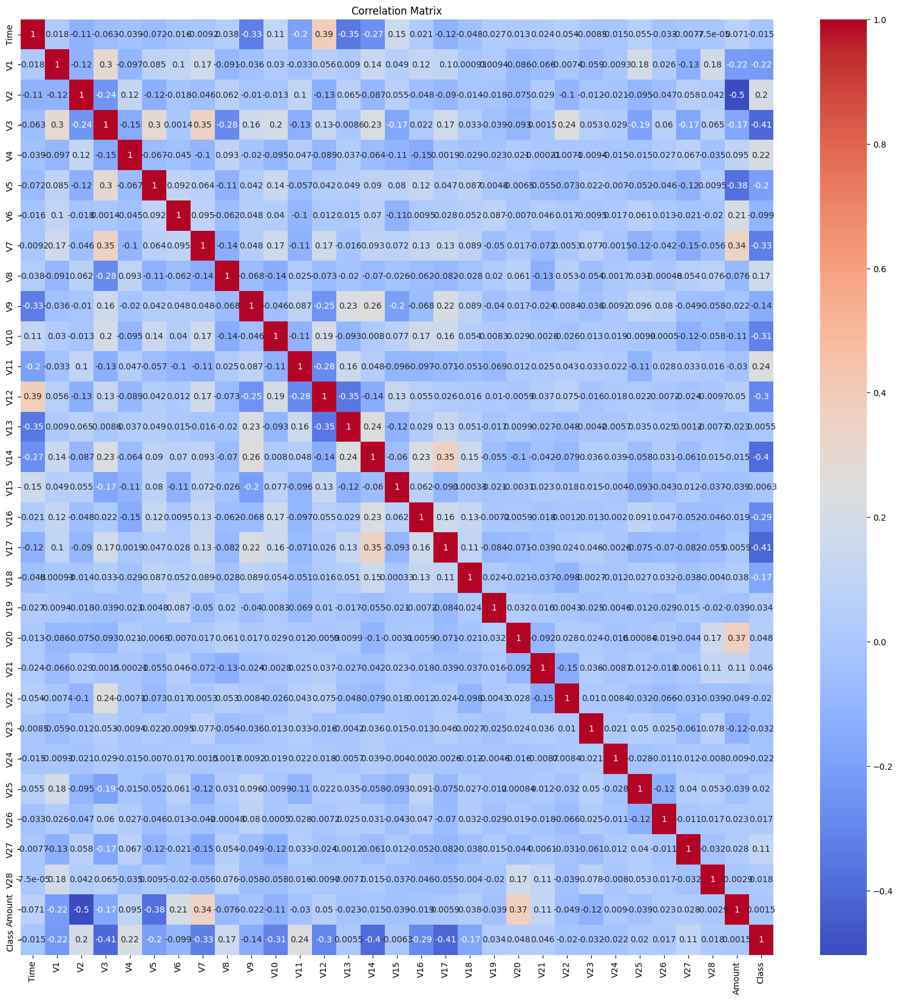

In [45]:

correlation_matrix = creditcard.corr()

plt.figure(figsize=(20,20))
sns.heatmap(correlation_matrix, annot= True, cmap= 'coolwarm')
plt.title('Correlation Matrix')
plt.show()


In [42]:
sns.pairplot(creditcard)


# Decision Tree Classifier

In [51]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix


In [52]:
X = creditcard.drop('Class', axis=1)  # Features (exclude 'Class')
y = creditcard['Class']  # Target variable

In [53]:
# Split the data into a training set and a test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)


In [54]:

# Create a Decision Tree Classifier
clf = DecisionTreeClassifier(max_depth=4, random_state=0)
# Fit the classifier to the training data
clf.fit(X_train, y_train)


DecisionTreeClassifier(max_depth=4, random_state=0)

In [55]:
# Make predictions on the test set
y_pred = clf.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
confusion = confusion_matrix(y_test, y_pred)

# Print the evaluation results
print(f'Accuracy: {accuracy:.2f}')
print('Confusion Matrix:')
print(confusion)



Accuracy: 1.00
Confusion Matrix:
[[7125    2]
 [   2   20]]


In [56]:
classification_rep = classification_report(y_test, y_pred)
print('Classification Report:')
print(classification_rep)

Classification Report:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      7127
         1.0       0.91      0.91      0.91        22

    accuracy                           1.00      7149
   macro avg       0.95      0.95      0.95      7149
weighted avg       1.00      1.00      1.00      7149



In [57]:
from sklearn.feature_selection import SelectFromModel

# Create a SelectFromModel instance to select features based on importance
sel = SelectFromModel(clf)  # Assuming 'clf' is your Decision Tree Classifier

# Fit the selector to the training data
sel.fit(X_train, y_train)

# Get the selected features
selected_features = X_train.columns[sel.get_support()]

# Print the number of selected features and the selected feature names
print("Number of selected features:", len(selected_features))
print("Selected features:", selected_features)


Number of selected features: 5
Selected features: Index(['V4', 'V9', 'V14', 'V17', 'V26'], dtype='object')


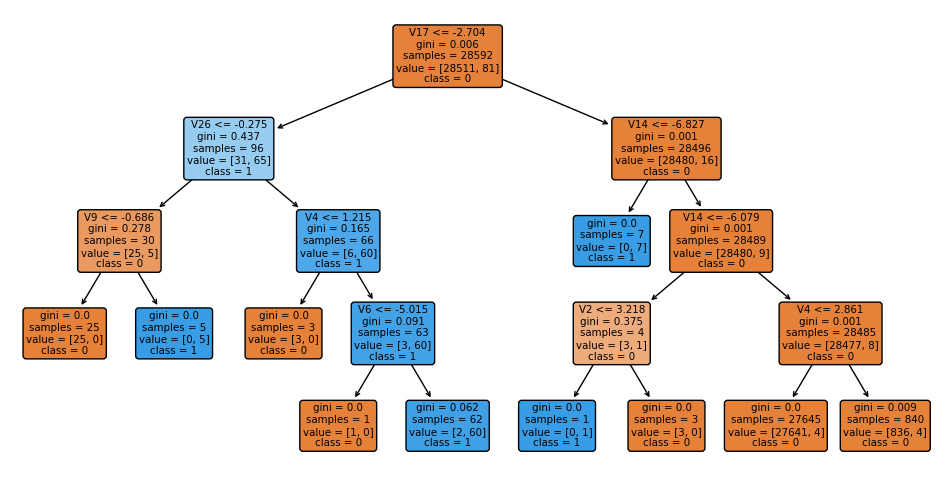

In [58]:
import matplotlib.pyplot as plt
from sklearn import tree

# Create a figure with a specified size
plt.figure(figsize=(12, 6))

# Plot the decision tree
tree.plot_tree(clf, feature_names=X.columns, class_names=['0', '1'], filled=True, rounded=True)

# Display the plot
plt.show()


# Random Forest Classifier

In [46]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel
from collections import Counter

# Create a Random Forest Classifier with the desired number of estimators
rf_clf = RandomForestClassifier(n_estimators=100)

# Fit the classifier to your training data
rf_clf.fit(X_train, y_train)


RandomForestClassifier()

In [47]:
# Make predictions on the test data
y_pred = rf_clf.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)

print(f'Accuracy: {accuracy:.2f}')


Accuracy: 1.00


In [48]:
from sklearn.metrics import classification_report, accuracy_score

classification_rep = classification_report(y_test, y_pred)

print('Classification Report:\n', classification_rep)


Classification Report:
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      7127
         1.0       1.00      0.95      0.98        22

    accuracy                           1.00      7149
   macro avg       1.00      0.98      0.99      7149
weighted avg       1.00      1.00      1.00      7149



In [49]:
sel = SelectFromModel(rf_clf)

# Fit the selector to the training data
sel.fit(X_train, y_train)

# Get the selected features
selected_features = X_train.columns[sel.get_support()]

# Print the number of selected features and the selected feature names
print("Number of selected features:", len(selected_features))
print("Selected features:", selected_features)


Number of selected features: 10
Selected features: Index(['V3', 'V4', 'V9', 'V10', 'V11', 'V12', 'V14', 'V16', 'V17', 'V26'], dtype='object')


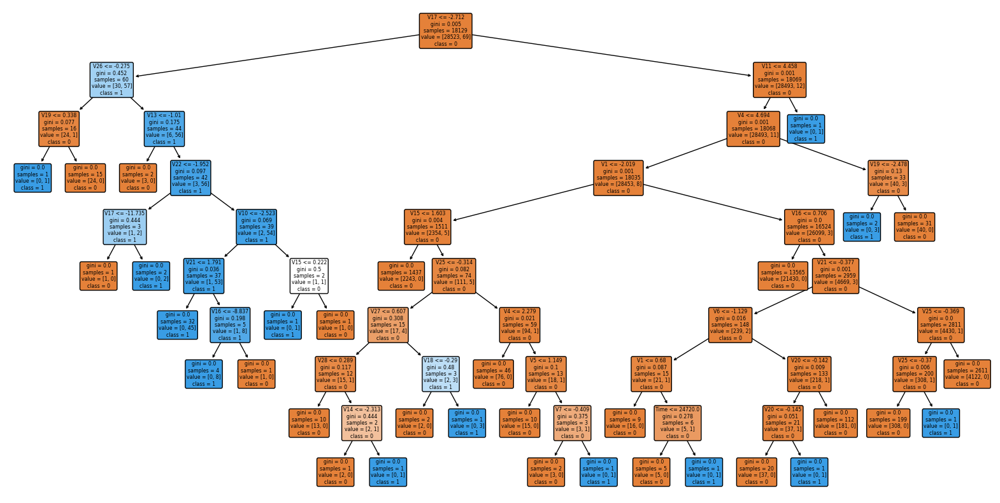

In [50]:
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier

# Create a figure with a specified size
plt.figure(figsize=(20, 10))
tree_in_forest = rf_clf.estimators_[0]

tree.plot_tree(tree_in_forest, feature_names=X.columns, class_names=['0', '1'], filled=True, rounded=True)

# Display the plot
plt.show()
